# Camera calibration (Zhang method) 🏁

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


20


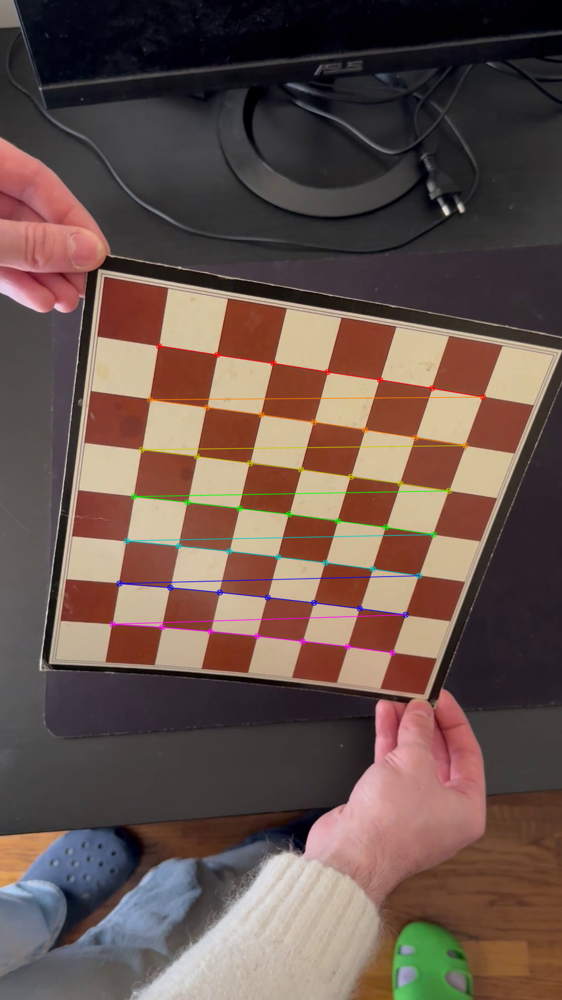

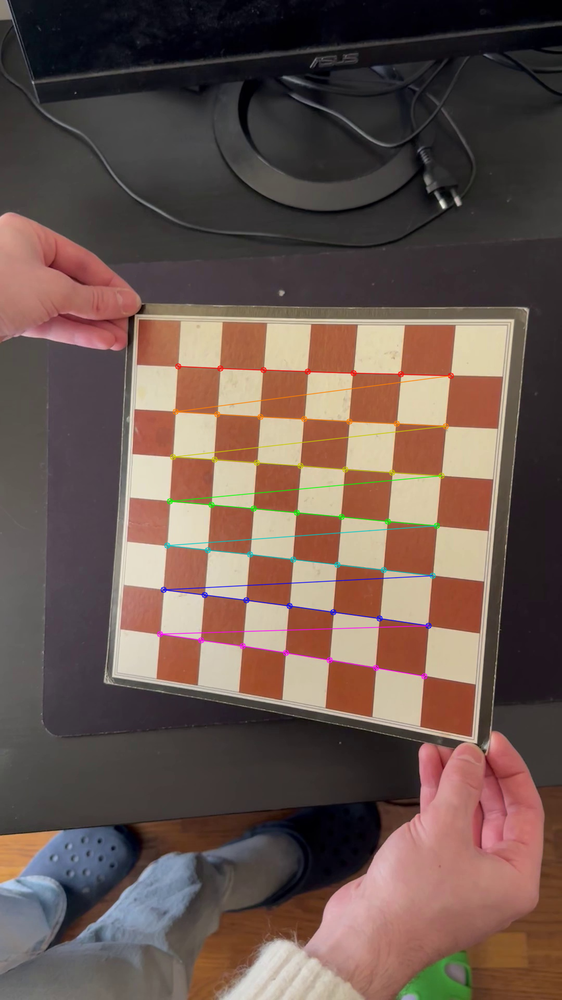

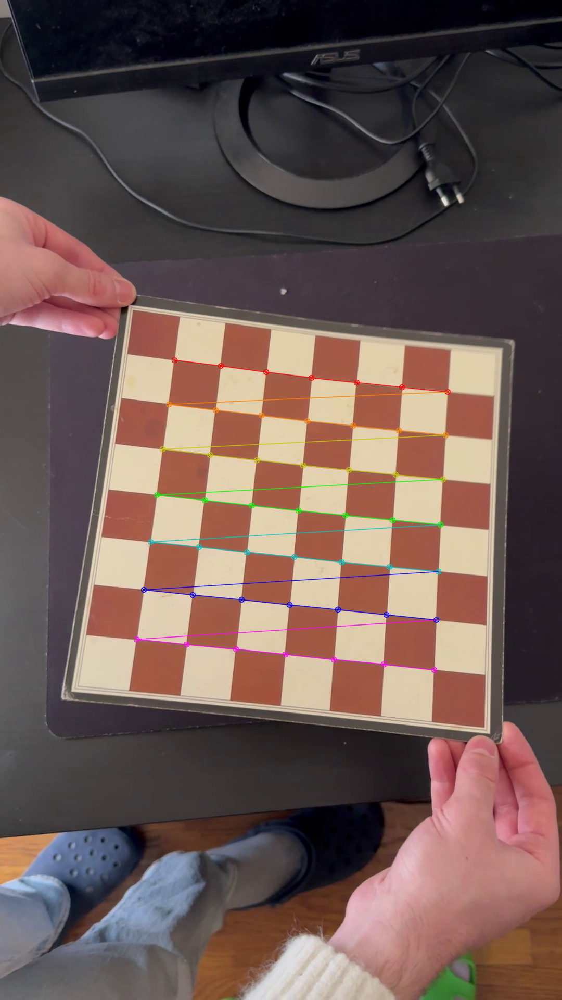

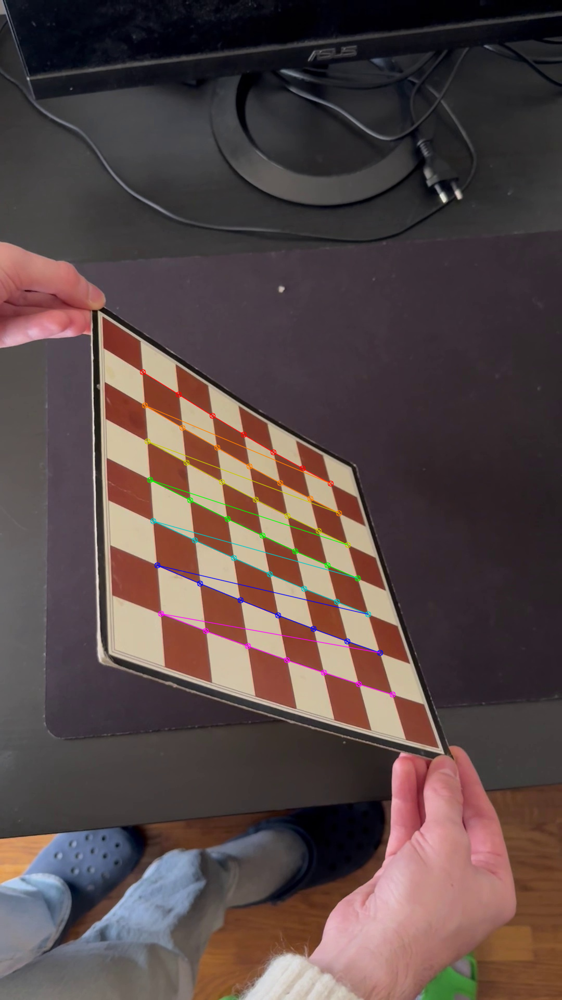

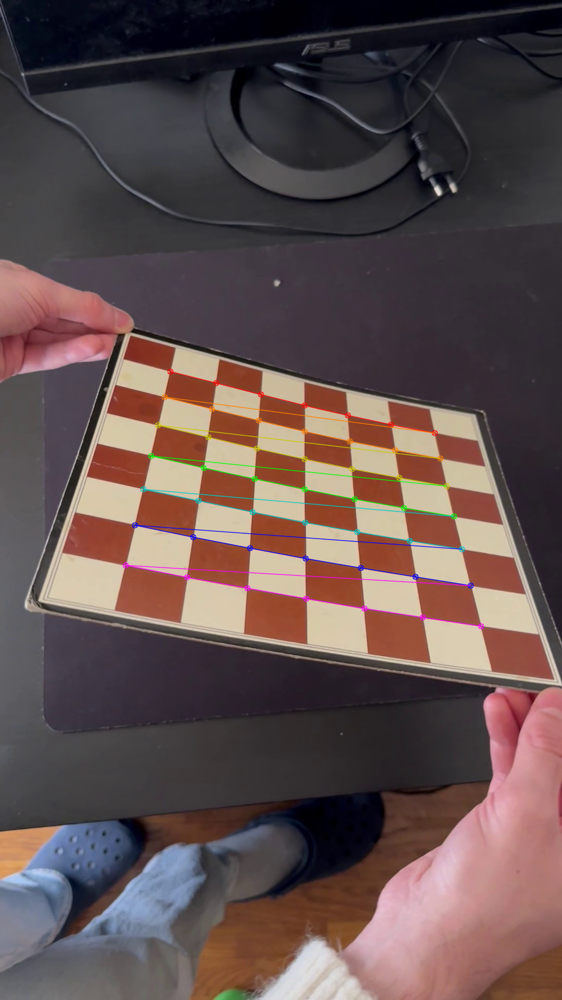

...

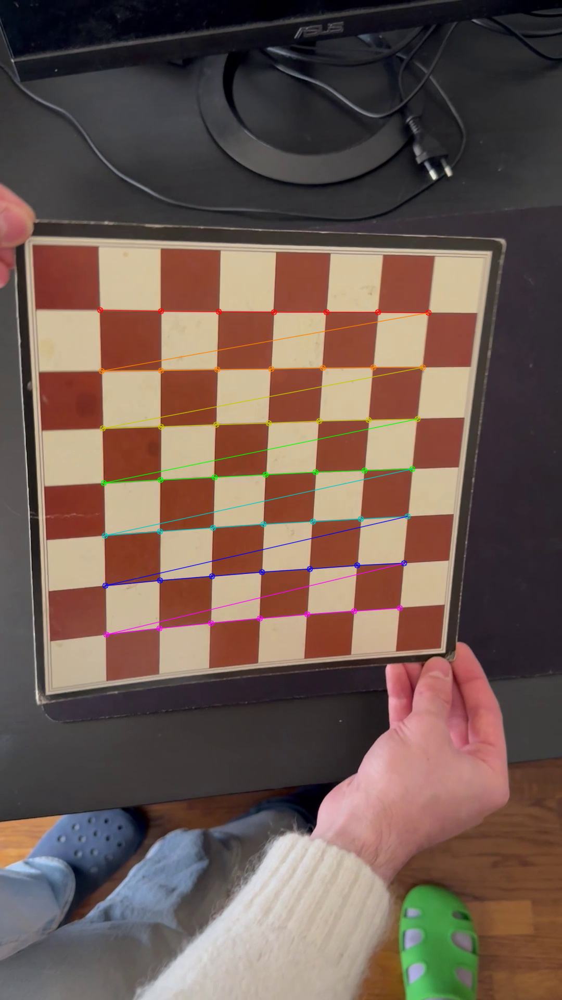

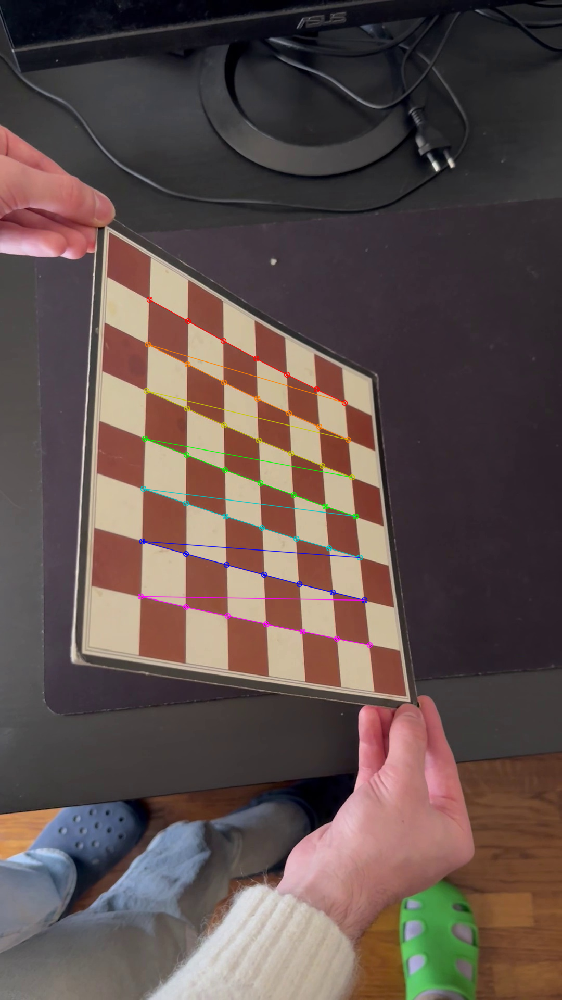

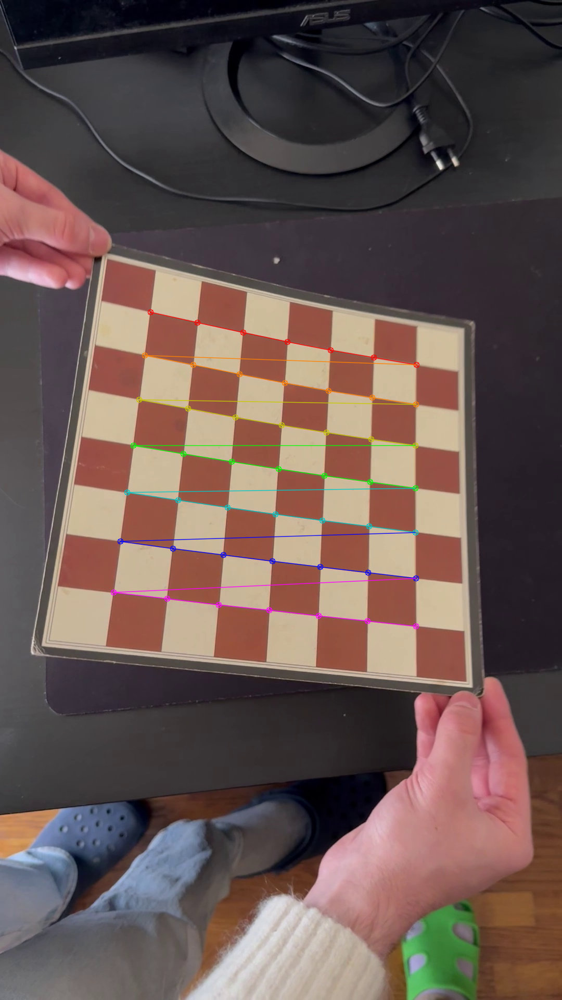

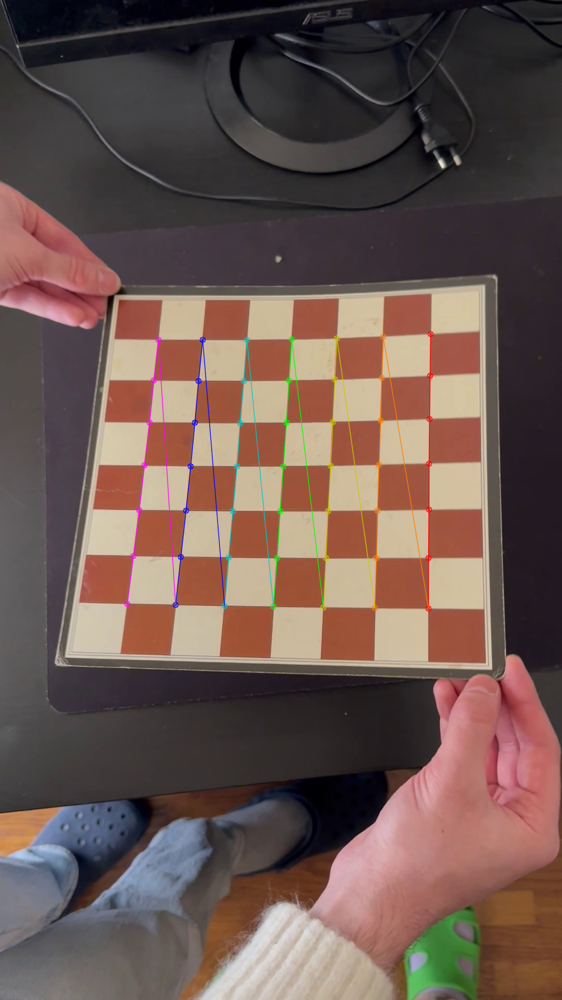

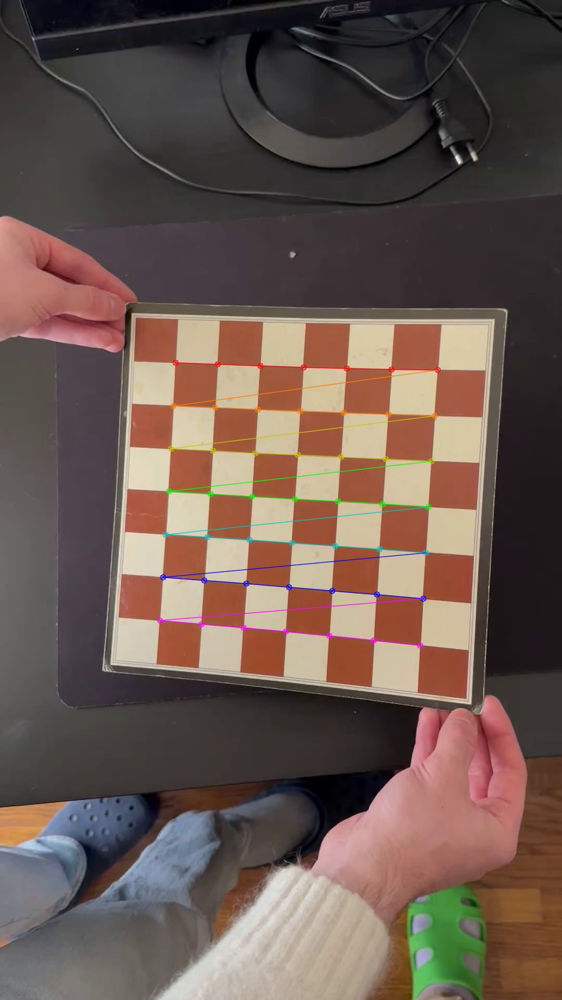

dist: [[ 0.30698233 -0.85344961 -0.05681402 -0.00679352  0.46338888]]
[[1.69948770e+03 0.00000000e+00 5.16343085e+02]
 [0.00000000e+00 1.72316579e+03 7.99990899e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
------------------
(array([[ 0.4184607 ],
       [-0.15777634],
       [ 0.18704933]]), array([[-0.05798906],
       [ 0.365254  ],
       [ 0.06628406]]), array([[-0.33255957],
       [-0.03959737],
       [ 0.10809693]]), array([[-0.81698719],
       [-0.78397619],
       [ 0.16672483]]), array([[-0.98990594],
       [-0.19959243],
       [ 0.1388086 ]]), array([[-0.97215875],
       [-0.19224948],
       [ 0.14852187]]), array([[-0.74276006],
       [-0.10590441],
       [ 0.15576373]]), array([[-0.99234083],
       [-0.18873757],
       [ 0.1236953 ]]), array([[-0.37775262],
       [-0.26448373],
       [ 0.13027689]]), array([[ 0.27699478],
       [-0.51827943],
       [ 1.49698553]]), array([[ 0.27305059],
       [-0.55028174],
       [ 1.47445971]]), array([[ 0.135418

In [10]:
import numpy as np
import glob
import pickle
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
import cv2 as cv

################ FIND CHESSBOARD CORNERS - OBJECT POINTS AND IMAGE POINTS #############################

chessboardSize = (7,7)
frameSize = (1920, 1080)

# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((chessboardSize[0] * chessboardSize[1], 3), np.float32)
objp[:,:2] = np.mgrid[0:chessboardSize[0],0:chessboardSize[1]].T.reshape(-1,2)

size_of_chessboard_squares_mm = 20
objp = objp * size_of_chessboard_squares_mm

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

images = glob.glob('/content/drive/My Drive/IACV/calibration/images/*.jpg')
output_path = '/content/drive/My Drive/IACV/calibration/outimages/'

print(len(images))
for i, image in enumerate(images):
    img = cv.imread(image)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, chessboardSize, None)

    # If found, add object points, image points (after refining them)
    if ret == True:

        objpoints.append(objp)
        corners2 = cv.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)

        # Draw and display the corners
        cv.drawChessboardCorners(img, chessboardSize, corners2, ret)
        #cv.imshow('img', img)
        cv.imwrite(f'{output_path}/{i}_out.jpg', img)
        cv2_imshow(img)
        cv.waitKey(1000)


cv.destroyAllWindows()
############## CALIBRATION #######################################################

ret, cameraMatrix, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, frameSize, None, None)

print("dist: " + str(dist))
print(cameraMatrix)
print("------------------")
print(rvecs)
print("------------------")
print(tvecs)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
#pickle.dump((cameraMatrix, dist), open( "/content/drive/My Drive/IACV/calibration/calibration.pkl", "wb" ))
#pickle.dump(cameraMatrix, open( "/content/drive/My Drive/IACV/calibration/cameraMatrix.pkl", "wb" ))
#pickle.dump(dist, open( "/content/drive/My Drive/IACV/calibration/dist.pkl", "wb" ))
